In [29]:
import pandas as pd
from pathlib import Path
from IPython.display import Audio as display_audio
import soundfile

ESC50 Dataset

In [27]:
DATA_PATH = Path('/Volumes/DataSSD/SoundSegment/ESC-50-master/')
META_PATH = DATA_PATH / 'meta'
AUDIO_PATH = DATA_PATH / 'audio'

In [4]:
data = pd.read_csv(META_PATH / 'esc50.csv')
data.head(10)

,filename,fold,target,category,esc10,src_file,take
0,1-100032-A-0.wav,1,0,dog,True,100032,A
1,1-100038-A-14.wav,1,14,chirping_birds,False,100038,A
2,1-100210-A-36.wav,1,36,vacuum_cleaner,False,100210,A
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B
4,1-101296-A-19.wav,1,19,thunderstorm,False,101296,A
5,1-101296-B-19.wav,1,19,thunderstorm,False,101296,B
6,1-101336-A-30.wav,1,30,door_wood_knock,False,101336,A
7,1-101404-A-34.wav,1,34,can_opening,False,101404,A
8,1-103298-A-9.wav,1,9,crow,False,103298,A
9,1-103995-A-30.wav,1,30,door_wood_knock,False,103995,A


In [8]:
# size of data
data.shape

(2000, 7)

In [6]:
data.target.nunique()

50

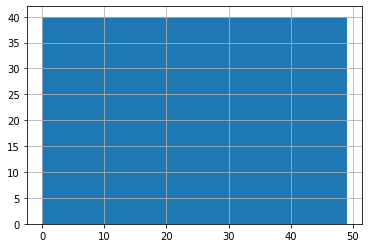

In [7]:
data.target.hist(bins=50)

In [16]:
sized = data.groupby('filename')['target'].count().reset_index()
sized

,filename,target
0,1-100032-A-0.wav,1
1,1-100038-A-14.wav,1
2,1-100210-A-36.wav,1
3,1-100210-B-36.wav,1
4,1-101296-A-19.wav,1
...,...,...
1995,5-263831-B-6.wav,1
1996,5-263902-A-36.wav,1
1997,5-51149-A-25.wav,1
1998,5-61635-A-8.wav,1


In [18]:
sized[sized['target'] > 1].shape

(0, 2)

In [33]:
x, sr = soundfile.read(AUDIO_PATH / data.loc[0, 'filename'])
x, sr

(array([0., 0., 0., ..., 0., 0., 0.]), 44100)

In [35]:
display_audio(AUDIO_PATH / data.loc[1, 'filename'])

In [36]:
display_audio(AUDIO_PATH / data.loc[0, 'filename'])

DESED dataset

In [20]:
DESED_DATA = '/Volumes/DataSSD/SoundSegment/dataset/'
STRONG_META = DESED_DATA + 'metadata/validation/'
STRONG_AUDIO = DESED_DATA + 'audio/validation/validation/'

In [21]:
df = pd.read_csv(STRONG_META + 'validation.tsv', sep='\t')
df.head(10)

,filename,onset,offset,event_label
0,Y00pbt6aJV8Y_350.000_360.000.wav,0.000,9.971,Vacuum_cleaner
1,Y00pK0GMmE9s_70.000_80.000.wav,0.000,10.000,Vacuum_cleaner
2,Y02sD1KJeoGA_50.000_60.000.wav,0.000,10.000,Frying
3,Y0bjUq9XMMmQ_30.000_40.000.wav,0.000,10.000,Frying
4,Y0cH_NlhhMAs_30.000_40.000.wav,1.710,6.005,Cat
5,Y0eh_N-cmcuI_350.000_360.000.wav,0.467,0.717,Alarm_bell_ringing
6,Y0eh_N-cmcuI_350.000_360.000.wav,1.919,10.000,Running_water
7,Y0eh_N-cmcuI_350.000_360.000.wav,5.418,5.863,Speech
8,Y0eh_N-cmcuI_350.000_360.000.wav,7.790,10.000,Speech
9,Y0hAK5f1tDok_30.000_40.000.wav,6.367,7.226,Cat


In [22]:
df.shape

(4251, 4)

In [26]:
df.groupby('filename').event_label.count().reset_index()

,filename,event_label
0,Y--4gqARaEJE_0.000_10.000.wav,5
1,Y--i-y1v8Hy8_0.000_9.000.wav,3
2,Y-0CamVQdP_Y_0.000_6.000.wav,1
3,Y-0X1juZHG6I_30.000_40.000.wav,1
4,Y-0nqfRcnAYE_370.000_380.000.wav,6
...,...,...
1163,YzVup1EYXcxA_10.000_20.000.wav,9
1164,YzY_7jujh3t4_300.000_310.000.wav,3
1165,YzcfvCrX-Lts_130.000_140.000.wav,5
1166,Yzh4tznWde1M_330.000_340.000.wav,1


In [37]:
display_audio(STRONG_AUDIO + df.loc[0, 'filename'])

In [38]:
display_audio(STRONG_AUDIO + df.loc[2, 'filename'])

In [39]:
display_audio(STRONG_AUDIO + df.loc[4, 'filename'])

In [41]:
# DESED Categories
df.event_label.unique()

array(['Vacuum_cleaner', 'Frying', 'Cat', 'Alarm_bell_ringing',
       'Running_water', 'Speech', 'Electric_shaver_toothbrush', 'Blender',
       'Dishes', 'Dog', nan], dtype=object)

In [42]:
# ESC50 Categories
data.category.unique()

array(['dog', 'chirping_birds', 'vacuum_cleaner', 'thunderstorm',
       'door_wood_knock', 'can_opening', 'crow', 'clapping', 'fireworks',
       'chainsaw', 'airplane', 'mouse_click', 'pouring_water', 'train',
       'sheep', 'water_drops', 'church_bells', 'clock_alarm',
       'keyboard_typing', 'wind', 'footsteps', 'frog', 'cow',
       'brushing_teeth', 'car_horn', 'crackling_fire', 'helicopter',
       'drinking_sipping', 'rain', 'insects', 'laughing', 'hen', 'engine',
       'breathing', 'crying_baby', 'hand_saw', 'coughing',
       'glass_breaking', 'snoring', 'toilet_flush', 'pig',
       'washing_machine', 'clock_tick', 'sneezing', 'rooster',
       'sea_waves', 'siren', 'cat', 'door_wood_creaks', 'crickets'],
      dtype=object)

Cat

In [45]:
data[data['category'] == 'cat'].sample(5)

,filename,fold,target,category,esc10,src_file,take
1973,5-259169-A-5.wav,5,5,cat,False,259169,A
1813,5-214759-A-5.wav,5,5,cat,False,214759,A
747,2-82274-A-5.wav,2,5,cat,False,82274,A
692,2-69131-B-5.wav,2,5,cat,False,69131,B
469,2-110011-A-5.wav,2,5,cat,False,110011,A


In [47]:
display_audio(AUDIO_PATH / data.loc[1973, 'filename'])

In [48]:
display_audio(AUDIO_PATH / data.loc[1813, 'filename'])

In [50]:
df[df['event_label'] == 'Cat'].sample(5)

,filename,onset,offset,event_label
2905,YmlpF226Gvlo_0.000_10.000.wav,1.888,4.090,Cat
3713,Y39rXWSXGOyo_80.000_90.000.wav,8.590,10.000,Cat
3805,YDjcbzPb1_Tk_30.000_40.000.wav,9.298,10.000,Cat
1237,Y2yX9079mMB4_3.000_13.000.wav,0.000,1.800,Cat
742,YO0MNy3e8lKg_10.000_20.000.wav,5.467,6.029,Cat


In [51]:
display_audio(STRONG_AUDIO + df.loc[2905, 'filename'])

In [52]:
display_audio(STRONG_AUDIO + df.loc[3713, 'filename'])

In [53]:
display_audio(STRONG_AUDIO + df.loc[1237, 'filename'])

Dog

In [55]:
data[data['category'] == 'dog'].sample(5)

,filename,fold,target,category,esc10,src_file,take
1490,4-194754-A-0.wav,4,0,dog,True,194754,A
521,2-122104-A-0.wav,2,0,dog,True,122104,A
1431,4-183992-A-0.wav,4,0,dog,True,183992,A
392,1-97392-A-0.wav,1,0,dog,True,97392,A
296,1-59513-A-0.wav,1,0,dog,True,59513,A


In [56]:
display_audio(AUDIO_PATH / data.loc[1490, 'filename'])

In [57]:
display_audio(AUDIO_PATH / data.loc[521, 'filename'])

In [58]:
df[df['event_label'] == 'Dog'].sample(5)

,filename,onset,offset,event_label
811,Y4hQgFX4vxi4_30.000_40.000.wav,5.045,5.697,Dog
3145,YN_bWjtccFg0_20.000_30.000.wav,1.371,2.348,Dog
2654,YEecU1KGJIt4_20.000_30.000.wav,1.493,1.743,Dog
790,Y4jZjNhgM7s4_14.000_24.000.wav,7.382,9.685,Dog
1689,YKRdvyjpQfoI_0.000_10.000.wav,4.109,4.412,Dog


In [59]:
display_audio(STRONG_AUDIO + df.loc[811, 'filename'])

In [60]:
display_audio(STRONG_AUDIO + df.loc[3145, 'filename'])

Vacuum Cleaner

In [61]:
data[data['category'] == 'vacuum_cleaner'].sample(5)

,filename,fold,target,category,esc10,src_file,take
527,2-122820-B-36.wav,2,36,vacuum_cleaner,False,122820,B
1372,4-172734-A-36.wav,4,36,vacuum_cleaner,False,172734,A
1674,5-182010-A-36.wav,5,36,vacuum_cleaner,False,182010,A
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B
298,1-60460-A-36.wav,1,36,vacuum_cleaner,False,60460,A


In [62]:
display_audio(AUDIO_PATH / data.loc[527, 'filename'])

In [63]:
display_audio(AUDIO_PATH / data.loc[1372, 'filename'])

In [64]:
df[df['event_label'] == 'Vacuum_cleaner'].sample(5)

,filename,onset,offset,event_label
3430,Y-kWlE2dkoxc_170.000_180.000.wav,0.000,10.0,Vacuum_cleaner
1909,YwMXiOt2HHUw_20.000_30.000.wav,0.000,10.0,Vacuum_cleaner
428,YB4Q6N08yhp8_80.000_90.000.wav,7.106,10.0,Vacuum_cleaner
979,Y3kx-UhywUf0_20.000_30.000.wav,6.420,10.0,Vacuum_cleaner
2445,YZRQ3vw3wNQ0_10.000_20.000.wav,2.506,10.0,Vacuum_cleaner


In [65]:
display_audio(STRONG_AUDIO + df.loc[3430, 'filename'])

In [66]:
display_audio(STRONG_AUDIO + df.loc[1909, 'filename'])

Pouring water / Running water

In [67]:
data[data['category'] == 'pouring_water'].sample(5)

,filename,fold,target,category,esc10,src_file,take
1348,4-168868-A-17.wav,4,17,pouring_water,False,168868,A
406,2-102414-D-17.wav,2,17,pouring_water,False,102414,D
407,2-102414-E-17.wav,2,17,pouring_water,False,102414,E
895,3-127874-A-17.wav,3,17,pouring_water,False,127874,A
242,1-50625-A-17.wav,1,17,pouring_water,False,50625,A


In [68]:
display_audio(AUDIO_PATH / data.loc[1348, 'filename'])

In [69]:
display_audio(AUDIO_PATH / data.loc[407, 'filename'])

In [70]:
df[df['event_label'] == 'Running_water'].sample(5)

,filename,onset,offset,event_label
4204,Y5iARe0XPQdg_95.000_105.000.wav,4.317,5.523,Running_water
1362,YcJv6x6TN1bw_480.000_490.000.wav,0.000,10.000,Running_water
280,Y5MB5gjMb1oo_240.000_250.000.wav,4.230,10.000,Running_water
3314,YRfTFFgqX58A_100.000_110.000.wav,0.040,10.000,Running_water
667,YRfbN44xVLWU_150.000_160.000.wav,6.224,9.129,Running_water


In [71]:
display_audio(STRONG_AUDIO + df.loc[4204, 'filename'])

In [74]:
display_audio(STRONG_AUDIO + df.loc[280, 'filename'])

In [75]:
common_categories = ['dog', 'cat', 'vacuum_cleaner', 'pouring_water']